In [21]:
import os
import flickrapi
import urllib
from PIL import Image
import urllib.request
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import json
import time
import datetime
import cv2 as cv
import glob
import imageio
import torch
from tqdm.auto import tqdm

In [2]:
# TODO:
# why are there multiple sparse folders? need to convert both folders
# do triangulation as in github repo
# 4d point is [x, y, z, 1]
# get min and max distances
# different intrisics


In [3]:
# DATASET = 'south-building'
# DATASET = 'rome_colosseum'
DATASET = 'trevi_fountain'
# DATASET = 'briksdalsbreen'

data_dir = f'data/{DATASET}/images/'
depth_data_dir = f'data/{DATASET}/depths/'

## TODO: check why id_to_timestamp does not contain all ids

In [7]:
with open(f'data/{DATASET}.json', 'r') as f:
    id_to_timestamp = json.load(f)

image_id_to_timetaken = {}
for image_id in id_to_timestamp:
    s = id_to_timestamp[image_id]['datetaken']
    unix_time = time.mktime(datetime.datetime.strptime(s, '%Y-%m-%d %H:%M:%S').timetuple())
    image_id_to_timetaken[image_id] = unix_time
del id_to_timestamp

In [9]:
# get intrisics
with open(f'data/{DATASET}/sparse/0/cameras.txt') as f:
    lines = f.readlines()
    
camera_id_to_data = {}

for line in lines:
    if '#' in line:
        continue
    line = line.replace('\n', '')
    CAMERA_ID, MODEL, WIDTH, HEIGHT, *PARAMS = line.split()
    WIDTH = int(WIDTH)
    HEIGHT = int(HEIGHT)

    camera_id_to_data[CAMERA_ID] = {'model': MODEL, 'width': WIDTH, 'height': HEIGHT, 'params': PARAMS}

camera_id_to_data

{'284': {'model': 'SIMPLE_RADIAL',
  'width': 800,
  'height': 450,
  'params': ['637.81134668778884', '400', '225', '-0.024713497208145221']},
 '280': {'model': 'SIMPLE_RADIAL',
  'width': 800,
  'height': 450,
  'params': ['522.4164325105661', '400', '225', '-0.031608369247046658']},
 '274': {'model': 'SIMPLE_RADIAL',
  'width': 799,
  'height': 533,
  'params': ['971.21388201402578', '399.5', '266.5', '-0.168230934966245']},
 '272': {'model': 'SIMPLE_RADIAL',
  'width': 800,
  'height': 614,
  'params': ['1459.277753778239', '400', '307', '-0.28842074471139734']},
 '269': {'model': 'SIMPLE_RADIAL',
  'width': 533,
  'height': 799,
  'params': ['745.56335363611413', '266.5', '399.5', '-0.15359425378801614']},
 '266': {'model': 'SIMPLE_RADIAL',
  'width': 800,
  'height': 600,
  'params': ['645.12246346194081', '400', '300', '-0.031811997335133686']},
 '264': {'model': 'SIMPLE_RADIAL',
  'width': 799,
  'height': 533,
  'params': ['647.42938603602499', '399.5', '266.5', '-0.0934443648

In [10]:
with open(f'data/{DATASET}/sparse/0/images.txt') as f:
    lines = f.readlines()  

img_filename_to_metadata = {}
img_filename_to_2d_points = {}

count = 0
point_2d_line = False
for line in lines:
    if '#' in line:
        continue
    line = line.replace('\n', '')
    
    if point_2d_line:
        assert len(line.split()) % 3 == 0
        points_2d = np.array(line.split()).reshape(-1, 3).astype(float)
        img_filename_to_2d_points[img_filename] = points_2d
        point_2d_line = False
    else:
        image_id, qw, qx, qy, qz, tx, ty, tz, camera_id, img_filename = line.split()
        qw, qx, qy, qz, tx, ty, tz = float(qw), float(qx), float(qy), float(qz), float(tx), float(ty), float(tz)
        img_filename_to_metadata[img_filename] = [image_id, qw, qx, qy, qz, tx, ty, tz, camera_id]
        point_2d_line = True
    
    count += 1
count

350

In [11]:
with open(f'data/{DATASET}/sparse/0/points3D.txt') as f:
    lines = f.readlines()   
    
point_id_to_data = {}

for line in lines:
    if '#' in line:
        continue
    line = line.replace('\n', '')
#     print(line.split())
#     qqq
    POINT3D_ID, X, Y, Z, R, G, B, ERROR, *TRACK = line.split()
    point_id_to_data[POINT3D_ID] = [X, Y, Z, R, G, B]

In [12]:
# img_filename_to_num_shared_points = {}

# plot = False
# plot_positions = False

# for img1_filename in tqdm(img_filename_to_metadata):
#     min_num_shared_points_for_img = float('inf')
    
#     _, qw1, qx1, qy1, qz1, tx1, ty1, tz1, _ = img_filename_to_metadata[img1_filename]
    
#     for img2_filename in img_filename_to_metadata:
#         if img1_filename == img2_filename:
#             continue
        
#         if plot:
#             fig, axs = plt.subplots(2, 2, squeeze=False)
#             fig.set_figheight(8)
#             fig.set_figwidth(20)

#         img1_points_2d = img_filename_to_2d_points[img1_filename]
#         img2_points_2d = img_filename_to_2d_points[img2_filename]
        
        
        
        
        
#         _, qw2, qx2, qy2, qz2, tx2, ty2, tz2, _ = img_filename_to_metadata[img2_filename]
        
#         dist_between_cameras = (((tx1 - tx2) ** 2) + ((ty1 - ty2) ** 2) + ((tz1 - tz2) ** 2)) ** 0.5
        
#         if dist_between_cameras > 1:
#             if plot_positions:
#                 axs[0][0].plot(-tx2, -tz2, color='red', linestyle='', marker='o', markersize=5)
#             continue
#         else:
#             if plot_positions:
#                 axs[0][0].plot(-tx2, -tz2, color='green', linestyle='', marker='o', markersize=5)
            
#         min_num_shared_points_for_img = min(min_num_shared_points_for_img, len(matched_observed_point_ids))

#         img1_observed_points_mask = np.isin(img1_observed_points_2d[:, 2], matched_observed_point_ids)
#         img2_observed_points_mask = np.isin(img2_observed_points_2d[:, 2], matched_observed_point_ids)

#         pts_src = img2_observed_points_2d[img2_observed_points_mask] 
#         pts_dst = img1_observed_points_2d[img1_observed_points_mask] 

#         # sort by 3d point id
#         pts_src = pts_src[pts_src[:, 2].argsort()] 
#         pts_dst = pts_dst[pts_dst[:, 2].argsort()] 
        
#         if plot:
#             axs[1][0].imshow(img1)
#             axs[1][0].plot(pts_dst[:, 0], pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)
#             axs[1][1].imshow(img2)
#             axs[1][1].plot(pts_src[:, 0], pts_src[:, 1], color='red', linestyle='', marker='o', markersize=2)

    
#     img_filename_to_num_shared_points[img1_filename] = min_num_shared_points_for_img
    


In [13]:
def get_matching_point_ids(img1_points_2d, img2_points_2d):
    img1_observed_points_2d = img1_points_2d[img1_points_2d[:, 2] != -1]
    img2_observed_points_2d = img2_points_2d[img2_points_2d[:, 2] != -1]

    # remove duplicate point ids
    img1_observed_point_unique_ids, img1_observed_point_unique_counts = np.unique(img1_observed_points_2d[:, 2], return_counts=True)
    img1_observed_point_non_duplicates = img1_observed_point_unique_ids[img1_observed_point_unique_counts == 1]
    img1_observed_points_mask = np.isin(img1_observed_points_2d[:, 2], img1_observed_point_non_duplicates)
    img1_observed_points_2d = img1_observed_points_2d[img1_observed_points_mask]

    img2_observed_point_unique_ids, img2_observed_point_unique_counts = np.unique(img2_observed_points_2d[:, 2], return_counts=True)
    img2_observed_point_non_duplicates = img2_observed_point_unique_ids[img2_observed_point_unique_counts == 1]
    img2_observed_points_mask = np.isin(img2_observed_points_2d[:, 2], img2_observed_point_non_duplicates)
    img2_observed_points_2d = img2_observed_points_2d[img2_observed_points_mask]

    img1_observed_point_ids = set(img1_observed_points_2d[:, 2])
    img2_observed_point_ids = set(img2_observed_points_2d[:, 2])

    matched_observed_point_ids = img1_observed_point_ids.intersection(img2_observed_point_ids)
    matched_observed_point_ids = list(matched_observed_point_ids)
    return matched_observed_point_ids
        
        
img_filename_to_num_shared_points = {}
img_filename_to_close_cameras = {}

plot = False # used for debugging only
plot_positions = False

if plot_positions:
    fig, axs = plt.subplots(1, 1, squeeze=False)
    fig.set_figheight(8)
    fig.set_figwidth(20)


for img1_filename in tqdm(img_filename_to_metadata):
    img_filename_to_close_cameras[img1_filename] = []
    min_num_shared_points_for_img = float('inf')
    
    _, qw1, qx1, qy1, qz1, tx1, ty1, tz1, _ = img_filename_to_metadata[img1_filename]
    
    if plot_positions:
        axs[0][0].plot(-tx1, -tz1, color='blue', linestyle='', marker='*', markersize=15)
        
        
    for img2_filename in img_filename_to_metadata:
        if img1_filename == img2_filename:
            continue
        
        if plot:
            fig, axs = plt.subplots(2, 2, squeeze=False)
            fig.set_figheight(8)
            fig.set_figwidth(20)

        img1_points_2d = img_filename_to_2d_points[img1_filename]
#         img1_observed_points_2d = img1_points_2d[img1_points_2d[:, 2] != -1]

        img1_save_path = os.path.join(data_dir, img1_filename)
        img1 = cv.imread(img1_save_path)  
        img1 = cv.cvtColor(img1, cv.COLOR_BGR2RGB)

        img2_points_2d = img_filename_to_2d_points[img2_filename]
#         img2_observed_points_2d = img2_points_2d[img2_points_2d[:, 2] != -1]

        img2_save_path = os.path.join(data_dir, img2_filename)
        img2 = cv.imread(img2_save_path)  
        img2 = cv.cvtColor(img2, cv.COLOR_BGR2RGB)
        
        if plot:
            axs[0][0].imshow(img1)
            axs[0][0].plot(img1_observed_points_2d[:, 0], img1_observed_points_2d[:, 1], color='red', linestyle='', marker='o', markersize=2)

            axs[0][1].imshow(img2)
            axs[0][1].plot(img2_observed_points_2d[:, 0], img2_observed_points_2d[:, 1], color='red', linestyle='', marker='o', markersize=2)
        
        matched_observed_point_ids = get_matching_point_ids(img1_points_2d, img2_points_2d)
        
        _, qw2, qx2, qy2, qz2, tx2, ty2, tz2, _ = img_filename_to_metadata[img2_filename]
        
        dist_between_cameras = (((tx1 - tx2) ** 2) + ((ty1 - ty2) ** 2) + ((tz1 - tz2) ** 2)) ** 0.5
        
        if dist_between_cameras > 1:
            if plot_positions:
                axs[0][0].plot(-tx2, -tz2, color='red', linestyle='', marker='o', markersize=5)
            continue
        else:
            img_filename_to_close_cameras[img1_filename].append(img2_filename)
            if plot_positions:
                axs[0][0].plot(-tx2, -tz2, color='green', linestyle='', marker='o', markersize=5)
            
#             print(tx2, ty2, tz2)
#             print('dist_between_cameras', dist_between_cameras)
#             print('num_matched_points', len(matched_observed_point_ids))
                
        
#         if len(matched_observed_point_ids) <= 10:
#             axs[0][0].plot(-tx2, -tz2, color='red', linestyle='', marker='o', markersize=5)
#             continue
#         else:
#             axs[0][0].plot(-tx2, -tz2, color='green', linestyle='', marker='o', markersize=5)

        min_num_shared_points_for_img = min(min_num_shared_points_for_img, len(matched_observed_point_ids))

        img1_observed_points_mask = np.isin(img1_points_2d[:, 2], matched_observed_point_ids)
        img2_observed_points_mask = np.isin(img2_points_2d[:, 2], matched_observed_point_ids)

        pts_src = img2_points_2d[img2_observed_points_mask] 
        pts_dst = img1_points_2d[img1_observed_points_mask] 

        # sort by 3d point id
        pts_src = pts_src[pts_src[:, 2].argsort()] 
        pts_dst = pts_dst[pts_dst[:, 2].argsort()] 
        
        if plot:
            axs[1][0].imshow(img1)
            axs[1][0].plot(pts_dst[:, 0], pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)
            axs[1][1].imshow(img2)
            axs[1][1].plot(pts_src[:, 0], pts_src[:, 1], color='red', linestyle='', marker='o', markersize=2)

    
    img_filename_to_num_shared_points[img1_filename] = min_num_shared_points_for_img
    


100%|█████████████████████████████████████████| 175/175 [06:51<00:00,  2.35s/it]


In [31]:
# sort
img_filename_to_num_shared_points = {k: v for k, v in sorted(img_filename_to_num_shared_points.items(), key=lambda item: -item[1] if item[1] != float('inf') else 0)}
img_filename_to_close_cameras = {k: v for k, v in sorted(img_filename_to_close_cameras.items(), key=lambda item: -len(item[1]))}

In [35]:
def project(src_pts, H):
    src_pts[:, 2] = 1
    projected_points = src_pts.dot(H)
    projected_points = projected_points / projected_points[:, 2].reshape(-1, 1)
    return projected_points

def run_ransac(pts_src, pts_dst, num_iterations, verbose=False):
    max_inliers = 0
    epsilon = 1

    for _ in range(num_iterations):
        random_indices = np.random.choice(np.arange(len(pts_src)), 4, replace=False)
        random_pts_src = pts_src[random_indices] 
        random_pts_dst = pts_dst[random_indices] 

        H, status = cv.findHomography(random_pts_src[:, :2], random_pts_dst[:, :2], 0)
        H = H.T
        projected_points = project(pts_src.copy(), H)
        distances = (((pts_dst[:, :2] - projected_points[:, :2])**2).sum(axis=1)**0.5)
        num_inliers = (distances < epsilon).sum()

        # Keep largest set of inliers
        if num_inliers > max_inliers:
            if verbose:
                print('max_inliers', max_inliers)
            max_inliers = num_inliers
            inlier_cordinates_for_maximum = np.where(distances < epsilon)
    return inlier_cordinates_for_maximum

  0%|                                                   | 0/175 [00:00<?, ?it/s]

num matched files: 38
4 4
18 18
6 6
8 8
26 26
20 20
5 5
28 28
10 10
42 42
38 38
28 28
37 37
7 7
42 42
36 36
11 11
31 31
17 17
28 28
13 13
12 12
16 16
48 48
269 269


/var/folders/9s/g1hj1n4d7mxb1tqyw0w5m1vc0000gn/T/ipykernel_43713/763010527.py:4: RuntimeWarning: divide by zero encountered in divide
  projected_points = projected_points / projected_points[:, 2].reshape(-1, 1)
/var/folders/9s/g1hj1n4d7mxb1tqyw0w5m1vc0000gn/T/ipykernel_43713/763010527.py:4: RuntimeWarning: invalid value encountered in divide
  projected_points = projected_points / projected_points[:, 2].reshape(-1, 1)


51 51
307 307
21 21
163 163
206 206
33 33
1767 1767
24 24
27 27


  0%|                                                   | 0/175 [01:03<?, ?it/s]

18 18


NameError: name 'qqq' is not defined

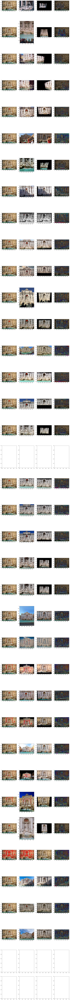

In [36]:
# TODO: add as argument    
num_iterations = int(2e4)

# TODO: rename
image_stack_no_alignment = []
image_stack_homography_alignment = []
image_stack_stereo_alignment = []

# for img1_filename in tqdm(img_filename_to_num_shared_points):
for img1_filename in tqdm(img_filename_to_close_cameras):
    
    min_num_shared_points_for_img = img_filename_to_num_shared_points[img1_filename]
    matched_filenames = img_filename_to_close_cameras[img1_filename]
    
    
    matched_filenames_filtered = []
    
    matched_filenames_filtered.append(img1_filename)
    
    for filename in matched_filenames:
        if filename.replace('.jpg', '') in image_id_to_timetaken:
            matched_filenames_filtered.append(filename)
        elif filename == img1_filename:
            # if we don't have the date for the reference image, that's not good
            qqq
    
    print('num matched files:', len(matched_filenames_filtered))
    matched_filenames_filtered = sorted(matched_filenames_filtered, key=lambda x: image_id_to_timetaken[x.replace('.jpg', '')])



    
    fig, axs = plt.subplots(len(matched_filenames), 4, squeeze=False)
    fig.set_figheight(8*len(matched_filenames))
    fig.set_figwidth(20)
        
        
     # TODO: move out of inner loop
    img1_save_path = os.path.join(data_dir, img1_filename)
    img1 = cv.imread(img1_save_path)
    img1 = cv.cvtColor(img1, cv.COLOR_BGR2RGB)
    
    image_stack_no_alignment.append(img1)
    image_stack_homography_alignment.append(img1)
    
    


    for row, img2_filename in enumerate(matched_filenames_filtered):
#     for row, img2_filename in enumerate(matched_filenames):
       
        img2_save_path = os.path.join(data_dir, img2_filename)
        img2 = cv.imread(img2_save_path)
        img2 = cv.cvtColor(img2, cv.COLOR_BGR2RGB)
        
#         image_stack_no_alignment.append(img2)
        image_stack_no_alignment.append(cv.resize(img2, dsize=(img1.shape[1], img1.shape[0]), interpolation=cv.INTER_CUBIC))

        # TODO: move out of inner loop
        img1_points_2d = img_filename_to_2d_points[img1_filename]
        img2_points_2d = img_filename_to_2d_points[img2_filename]
        matched_observed_point_ids = get_matching_point_ids(img1_points_2d, img2_points_2d)
        
        if len(matched_observed_point_ids) < 4:
            continue
        
        img1_matched_points_mask = np.isin(img1_points_2d[:, 2], matched_observed_point_ids)
        img2_matched_points_mask = np.isin(img2_points_2d[:, 2], matched_observed_point_ids)

        pts_src = img2_points_2d[img2_matched_points_mask] #[:, :2]
        pts_dst = img1_points_2d[img1_matched_points_mask] #[:, :2]

        # sort by 3d point id
        pts_src = pts_src[pts_src[:, 2].argsort()] 
        pts_dst = pts_dst[pts_dst[:, 2].argsort()] 
        
        # TODO: assert length is the same
        assert len(pts_src) == len(pts_dst)

        # run ransac
        inlier_cordinates_for_maximum = run_ransac(pts_src, pts_dst, num_iterations)
        
        inlier_pts_src = pts_src[inlier_cordinates_for_maximum[0]] 
        inlier_pts_dst = pts_dst[inlier_cordinates_for_maximum[0]] 
        print(len(inlier_pts_src), len(inlier_pts_dst))

        
        H, status = cv.findHomography(inlier_pts_src[:, :2], inlier_pts_dst[:, :2], 0)
        im_dst = cv.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))
        image_stack_homography_alignment.append(im_dst)

        

        axs[row][0].imshow(img1)
        axs[row][0].plot(inlier_pts_dst[:, 0], inlier_pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)
        axs[row][1].imshow(img2)
        axs[row][1].plot(inlier_pts_src[:, 0], inlier_pts_src[:, 1], color='red', linestyle='', marker='o', markersize=2)
        axs[row][2].imshow(im_dst)
        axs[row][3].imshow(((img1+im_dst)/2).astype(int))
                
        
    qqq


In [37]:
image_stack_no_alignment = np.array(image_stack_no_alignment)
image_stack_homography_alignment = np.array(image_stack_homography_alignment)
image_stack_stereo_alignment = np.array(image_stack_stereo_alignment)

/Users/nabeel/anaconda3/envs/env_294/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/nabeel/anaconda3/envs/env_294/lib/python3.8/site-packages/numpy/core/_methods.py:190: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


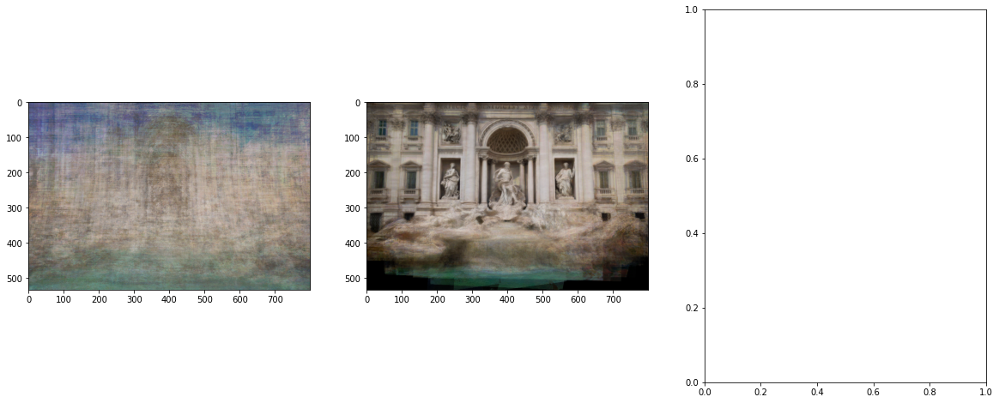

In [38]:
fig, axs = plt.subplots(1, 3, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)

m0 = np.median(image_stack_no_alignment, axis=0).astype(int)
m1 = np.median(image_stack_homography_alignment, axis=0).astype(int)
m2 = np.median(image_stack_stereo_alignment, axis=0).astype(int)

axs[0][0].imshow(m0)
axs[0][1].imshow(m1)
# axs[0][2].imshow(m2)

In [39]:
output_dir = 'outputs'
os.makedirs(output_dir, exist_ok=True)
imageio.mimsave(os.path.join(output_dir, 'test.gif'), image_stack_homography_alignment, fps=10)

In [66]:
image_stack_homography_alignment.shape

(36, 533, 800, 3)

In [77]:
image_stack_homography_alignment = image_stack_homography_alignment[:, 50:-70, 200:-200, :]

In [78]:
# plt.imshow(image_stack_homography_alignment[0, 50:-70, 200:-200])

In [87]:
x = torch.tensor(image_stack_homography_alignment)
# y = torch.randint(0, 255, size=image_stack_homography_alignment.shape).float()
y = x.clone().float()
y.requires_grad = True

def custom_loss(x, y, lmbd=0.5):
    loss0 = torch.mean((x - y)**2, axis=[1,2,3]).sum()
    loss1 = torch.mean((y[1:]-y[:-1])**2, axis=[1,2,3]).sum()
    loss = loss0 + lmbd * loss1
    return loss

loss = custom_loss(x, y)
loss

tensor(121880.9453, grad_fn=<AddBackward0>)

In [88]:
optimizer = torch.optim.Adam([y], lr=1)
optimizer.zero_grad()
losses = []

num_steps = 500
lmbd = 100

for _ in tqdm(range(num_steps)):
    loss = custom_loss(x, y, lmbd=lmbd)
    losses.append(loss.item())
#     optimizer.append(loss.item())
    optimizer.zero_grad()

    loss.backward()
    optimizer.step()
    
#     print(torch.mean((x - y)**2))

100%|█████████████████████████████████████████| 500/500 [03:06<00:00,  2.68it/s]


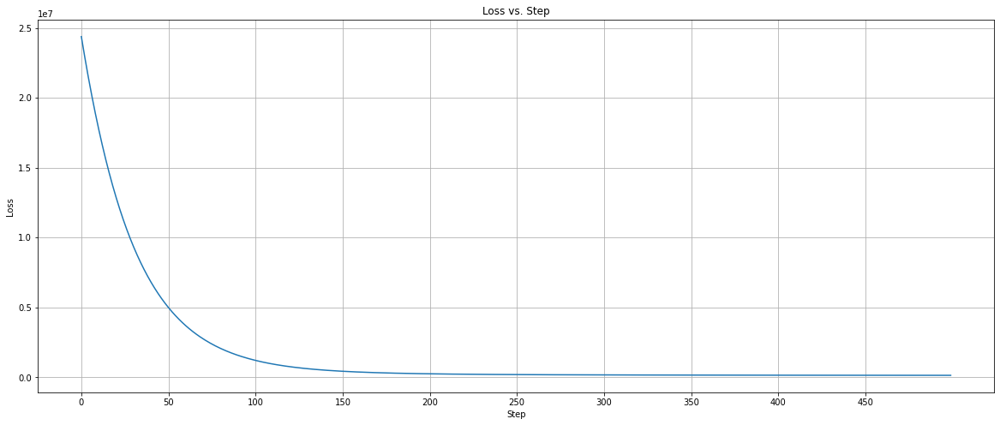

In [92]:
fig, axs = plt.subplots(1, 1, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)

axs[0][0].plot(np.arange(num_steps), losses)
axs[0][0].set_title('Loss vs. Step')
axs[0][0].set_xlabel('Step')
axs[0][0].set_ylabel('Loss')
# axs[0][0].set_yscale('log')
axs[0][0].set_xticks(np.arange(0, num_steps, 50))
axs[0][0].grid(True)

In [93]:
output_dir = 'outputs'
os.makedirs(output_dir, exist_ok=True)
image_stack_homography_alignment_smoothed = y.detach().numpy().astype(np.uint8)
image_stack_homography_alignment_smoothed = np.clip(image_stack_homography_alignment_smoothed, 0, 255)
imageio.mimsave(os.path.join(output_dir, 'test1.gif'), image_stack_homography_alignment_smoothed, fps=10)

In [91]:
loss.item()

141117.21875

In [56]:
image_stack_homography_alignment_smoothed.max()

194

In [48]:
image_stack_homography_alignment_smoothed.dtype

dtype('int64')

In [204]:
torch.mean((x - y)**2)

tensor(11260.7207, grad_fn=<MeanBackward0>)

In [162]:
x.min()

tensor(2.3842e-07)

In [ ]:
# criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)


In [138]:
image_stack_homography_alignment_smoothed = []
moving_window_length = 10
moving_window = list(image_stack_homography_alignment[:moving_window_length])
image_stack_homography_alignment_smoothed.append(np.median(moving_window, axis=0))

for image in image_stack_homography_alignment[moving_window_length:]:
    moving_window = moving_window[1:]
    moving_window.append(image)
    image_stack_homography_alignment_smoothed.append(np.median(moving_window, axis=0))
#     running_median = np.median(running_median, image)
#     image_stack_homography_alignment_smoothed.append(running_median)
image_stack_homography_alignment_smoothed = np.array(image_stack_homography_alignment_smoothed)

In [149]:
# need to change to int
image_stack_homography_alignment_smoothed.dtype

dtype('float64')

In [139]:
image_stack_homography_alignment_smoothed.shape

(27, 533, 800, 3)

In [141]:
imageio.mimsave(os.path.join(output_dir, 'test_smoothed.gif'), image_stack_homography_alignment_smoothed, fps=20)

Lossy conversion from float64 to uint8. Range [0.0, 240.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.0, 241.5]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.0, 241.5]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.0, 247.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.0, 247.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.0, 247.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.0, 248.0]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0.0, 248.0]. Convert image to uint8 prior to saving to suppress this warning.


In [128]:
image_stack_homography_alignment.shape

(36, 533, 800, 3)

In [127]:
image_stack_homography_alignment_smoothed.shape

(34, 533, 800, 3)

In [116]:
image_stack_homography_alignment_smoothed = []
running_median = image_stack_homography_alignment[0]

for image in image_stack_homography_alignment[1:]:
    running_median = np.median(running_median, image)
    image_stack_homography_alignment_smoothed.append(running_median)
image_stack_homography_alignment_smoothed = np.array(image_stack_homography_alignment_smoothed)

do


TypeError: only integer scalar arrays can be converted to a scalar index

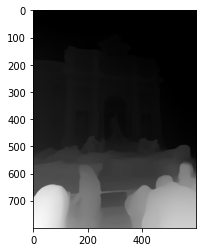

In [22]:
img1_filename_png = img1_filename.replace('.jpg', '.png')
img1_depth_save_path = os.path.join(depth_data_dir, img1_filename_png)
img1_depth_map = cv.imread(img1_depth_save_path)
img1_depth_map = img1_depth_map[:, :, 0]
# plt.hist(img1_depth_map.reshape(-1, 1))
plt.imshow(img1_depth_map, cmap='gray')
# img2 = cv.cvtColor(img2, cv.COLOR_BGR2RGB)
        

In [23]:
def quantize_image(image, n_levels):
    # Get the height and width of the image
    height, width = image.shape[:2]

    # Create an array of the same size as the image containing the
    # quantized values of the pixels
    quantized_image = (image // n_levels).astype(np.uint8)

    return quantized_image

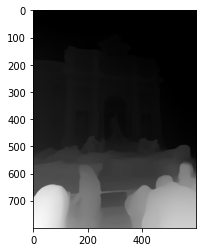

In [24]:
img1_depth_map_quantized = quantize_image(img1_depth_map, n_levels=int(255/200))
plt.imshow(img1_depth_map_quantized, cmap='gray')


In [165]:
def get_image_intrisics(camera_id, camera_id_to_data):
    data = camera_id_to_data[camera_id]
    model = data['model']
    params = data['params']
    
    if model in ['SIMPLE_PINHOLE', 'SIMPLE_RADIAL', 'RADIAL']:
        fx, fy, cx, cy = params
        
    # intrinsics
    K = np.identity(3)
    K[0, 0] = fx
    K[1, 1] = fy
    K[0, 2] = cx
    K[1, 2] = cy
    return K


# def qvec2rotmat_scipy(qvec):
#     from scipy.spatial.transform import Rotation as SR
#     r = SR.from_quat(qvec)
#     return r.as_matrix()

def qvec2rotmat(qvec):
    return np.array([
        [1 - 2 * qvec[2]**2 - 2 * qvec[3]**2,
         2 * qvec[1] * qvec[2] - 2 * qvec[0] * qvec[3],
         2 * qvec[3] * qvec[1] + 2 * qvec[0] * qvec[2]],
        [2 * qvec[1] * qvec[2] + 2 * qvec[0] * qvec[3],
         1 - 2 * qvec[1]**2 - 2 * qvec[3]**2,
         2 * qvec[2] * qvec[3] - 2 * qvec[0] * qvec[1]],
        [2 * qvec[3] * qvec[1] - 2 * qvec[0] * qvec[2],
         2 * qvec[2] * qvec[3] + 2 * qvec[0] * qvec[1],
         1 - 2 * qvec[1]**2 - 2 * qvec[2]**2]])

def get_image_extrinsics(img_filename, img_filename_to_metadata):
    image_id, qw, qx, qy, qz, tx, ty, tz, camera_id = img_filename_to_metadata[img_filename]
    R = qvec2rotmat([qw, qx, qy, qz])
#     R = qvec2rotmat_scipy([qw, qx, qy, qz])
    T = np.array([tx, ty, tz])
    
    # TODO: need to invert?
#     T = -R.T @ T
#     R = R.T
     
    return R, T
    
_, _, _, _, _, _, _, _, img1_camera_id = img_filename_to_metadata[img1_filename]
_, _, _, _, _, _, _, _, img2_camera_id = img_filename_to_metadata[img2_filename]

img1_intrisic = get_image_intrisics(img1_camera_id, camera_id_to_data)
img1_R, img1_T = get_image_extrinsics(img1_filename, img_filename_to_metadata)
img1_extrinsic = np.hstack((img1_R, np.expand_dims(img1_T, axis=1)))

# TODO: do we need to add this
img1_intrisic = np.hstack((img1_intrisic, np.array([[0], [0], [0]])))
img1_extrinsic = np.vstack((img1_extrinsic, np.array([0, 0, 0, 1])))

img2_intrisic = get_image_intrisics(img2_camera_id, camera_id_to_data)
img2_R, img2_T = get_image_extrinsics(img2_filename, img_filename_to_metadata)
img2_extrinsic = np.hstack((img2_R, np.expand_dims(img2_T, axis=1)))

# TODO: do we need to add this
img2_intrisic = np.hstack((img2_intrisic, np.array([[0], [0], [0]])))
img2_extrinsic = np.vstack((img2_extrinsic, np.array([0, 0, 0, 1])))

img1_intrisic, img1_extrinsic, img2_intrisic, img2_extrinsic

(array([[5.44315109e+02, 0.00000000e+00, 4.00000000e+02, 0.00000000e+00],
        [0.00000000e+00, 3.00000000e+02, 6.51677078e-02, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 1.00000000e+00, 0.00000000e+00]]),
 array([[ 0.97900924, -0.0593124 , -0.19499472,  1.4798654 ],
        [ 0.04750626,  0.9967747 , -0.06467889,  0.30439032],
        [ 0.19820206,  0.05405776,  0.97866935,  1.24636465],
        [ 0.        ,  0.        ,  0.        ,  1.        ]]),
 array([[4.27418655e+02, 0.00000000e+00, 2.25000000e+02, 0.00000000e+00],
        [0.00000000e+00, 4.00000000e+02, 4.64309078e-02, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 1.00000000e+00, 0.00000000e+00]]),
 array([[ 0.93429591, -0.11418696, -0.33771658,  1.66770241],
        [ 0.08860724,  0.99196812, -0.09026636,  0.36989023],
        [ 0.34531132,  0.05441135,  0.93690955,  2.2183175 ],
        [ 0.        ,  0.        ,  0.        ,  1.        ]]))

In [175]:
for img_id, img in images.items():
    if img.name == img1_filename:
        print(img.qvec2rotmat())
        qqq

[[ 0.97900924 -0.0593124  -0.19499472]
 [ 0.04750626  0.9967747  -0.06467889]
 [ 0.19820206  0.05405776  0.97866935]]


NameError: name 'qqq' is not defined

In [125]:
image_id, qw, qx, qy, qz, tx, ty, tz, camera_id = img_filename_to_metadata[img1_filename]
qvec2rotmat([qw, qx, qy, qz])

array([[ 0.97900924, -0.0593124 , -0.19499472],
       [ 0.04750626,  0.9967747 , -0.06467889],
       [ 0.19820206,  0.05405776,  0.97866935]])

In [126]:
image_id, qw, qx, qy, qz, tx, ty, tz, camera_id = img_filename_to_metadata[img1_filename]
qvec2rotmat_scipy([qw, qx, qy, qz])

array([[ 0.97866935,  0.06467889, -0.19499472],
       [ 0.05405776, -0.9967747 , -0.0593124 ],
       [-0.19820206,  0.04750626, -0.97900924]])

In [127]:
img1_intrisic.shape, img1_extrinsic.shape

((3, 4), (4, 4))

In [128]:
img_filename_to_metadata[img1_filename]

['152',
 0.994290361699477,
 0.029854621103665595,
 -0.09886367018844779,
 0.02685801457944313,
 1.479865403936149,
 0.30439032461541743,
 1.2463646525306964,
 '153']

In [129]:
# def project(x, y, z, K, Rt, Rt_ref):
#     # Define the 3D position of the point
#     P = np.array([x, y, z, 1])
#     x1, y1, z1, _ = (Rt @ np.linalg.inv(Rt_ref) @ P)
#     return x1, y1


# # def align_images(image1, image2, depth_map1):
# depth_map1 = img1_depth_map_quantized

# # Initialize the result image with the same size as image1
# result = np.zeros_like(img1)

# # Loop over the pixels of image2
# for x in tqdm(range(img1.shape[0])):
#     for y in range(img1.shape[1]):
#         # Get the 3D position of the current pixel
#         z = depth_map1[x, y]

#         # Project the 3D position into image2
#         x1, y1 = project(x, y, z, img1_intrisic, img1_extrinsic, img1_extrinsic)
                
#         # Check if the projection is inside the image boundary of image1
#         x1 = int(x1)
#         y1 = int(y1)
#         if x1 >= 0 and x1 < img1.shape[0] and y1 >= 0 and y1 < img1.shape[1]:

#             result[x1, y1] = img1[x, y]
# #             # Check if the pixel is occluded
# #             if depth_map1[x1, y1] > z:
# #                 # Inpaint the occluded pixels and add the current pixel to the result image
# #                 result[x1, y1] = inpaint(x1, y1, image1, image2[i, j])
# #             else:
# #                 # Add the current pixel to the result image
# #                 result[x1, y1] = image2[i, j]

# # return result



# plt.imshow(result)

In [130]:
# TODO: look if project function works between know correspondences

pid 84.0


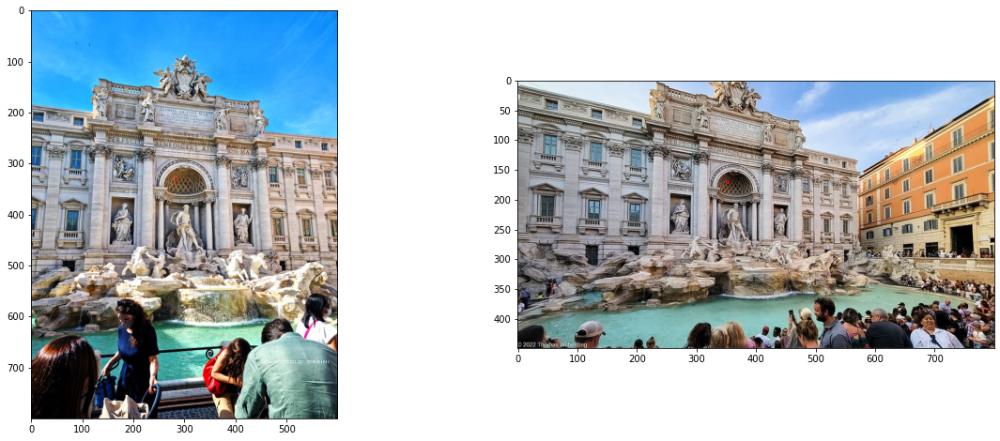

In [131]:
img1_points_2d = img_filename_to_2d_points[img1_filename]
img2_points_2d = img_filename_to_2d_points[img2_filename]
matched_observed_point_ids = get_matching_point_ids(img1_points_2d, img2_points_2d)

img1_matched_points_mask = np.isin(img1_points_2d[:, 2], matched_observed_point_ids)
img2_matched_points_mask = np.isin(img2_points_2d[:, 2], matched_observed_point_ids)

pts_dst = img1_points_2d[img1_matched_points_mask] #[:, :2]
pts_src = img2_points_2d[img2_matched_points_mask] #[:, :2]

# sort by 3d point id
pts_src = pts_src[pts_src[:, 2].argsort()] 
pts_dst = pts_dst[pts_dst[:, 2].argsort()] 

debug_index = 0
pid = pts_src[debug_index][2]
print('pid', pid)

fig, axs = plt.subplots(1, 2, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)

axs[0][0].imshow(img1)
axs[0][0].plot(pts_dst[debug_index, 0], pts_dst[debug_index, 1], color='red', linestyle='', marker='o', markersize=2)
axs[0][1].imshow(img2)
axs[0][1].plot(pts_src[debug_index, 0], pts_src[debug_index, 1], color='red', linestyle='', marker='o', markersize=2)

In [132]:
# = [X, Y, Z, R, G, B]
X, Y, Z, R, G, B = point_id_to_data[str(int(pid))] 
X, Y, Z = float(X), float(Y), float(Z)
print(X, Y, Z)
# project(X, Y, Z, img2_intrisic, img2_extrinsic, img1_extrinsic)

-0.42068056454101166 -0.8404979411556497 6.934832339247501


In [135]:
X_world = np.array([X, Y, Z, 1])
print('X_world', X_world)

K = img2_intrisic
T = img2_extrinsic

# Transform the 3D point to the camera coordinate system
X_cam = T@X_world

# Project the 3D point onto the image plane
x_pred = (X_cam[0] * K[0, 0] / X_cam[2]) + K[0, 2]
y_pred = (X_cam[1] * K[1, 1] / X_cam[2]) + K[1, 2]

x_true, y_true, _ = pts_src[0]
print('true:', x_true, y_true)
print('pred:', x_pred, y_pred)

X_world [-0.42068056 -0.84049794  6.93483234  1.        ]
true: 352.2493591308594 170.8111572265625
pred: 176.29614114517227 -52.84099553239386


In [134]:
X_world = np.array([X, Y, Z, 1])

K = img2_intrisic

T = img2_extrinsic

x_pred, y_pred, u = K@T@X_world
x_pred = x_pred / u
y_pred = y_pred / u
# print('true:', X, Y)
x_true, y_true, _ = pts_src[0]
print('true:', x_true, y_true)
print('pred:', x_pred, y_pred)

true: 352.2493591308594 170.8111572265625
pred: 176.2961411451723 -52.84099553239386


In [68]:
def project_point(X, Y, Z, K, Rt):
    X_world = np.array([X, Y, Z, 1])
    # Transform the 3D point to the camera coordinate system
    X_cam = Rt@X_world

    # Project the 3D point onto the image plane
    x_pred = (X_cam[0] * K[0, 0] / X_cam[2]) + K[0, 2]
    y_pred = (X_cam[1] * K[1, 1] / X_cam[2]) + K[1, 2]
    
    return x_pred, y_pred
    
# def unproject_point(x, y, z, K, Rt):
#     # Unproject the 2D point to a 3D point
#     X = (Z / K[0, 0]) * (x - K[0, 2])
#     Y = (Z / K[1, 1]) * (y - K[1, 2])

#     # Project the 3D point onto the image plane
#     x_pred = (X_cam[0] * K[0, 0] / X_cam[2]) + K[0, 2]
#     y_pred = (X_cam[1] * K[1, 1] / X_cam[2]) + K[1, 2]
    
#     X_world = np.array([X, Y, Z, 1])
#     return X_world
    

In [69]:
x_true, y_true, pid = pts_src[0]
X, Y, Z, R, G, B = point_id_to_data[str(int(pid))] 
X, Y, Z = float(X), float(Y), float(Z)
x_pred, y_pred = project_point(X, Y, Z, img2_intrisic, img2_extrinsic)
print('true:', x_true, y_true)
print('pred:', x_pred, y_pred)

true: 352.2493591308594 170.8111572265625
pred: 176.29614114517227 -52.84099553239386


[1502.8593269  -450.44992172    8.52462973]
true: 352.2493591308594 170.8111572265625
pred: 176.29614114517227 -52.84099553239386


In [34]:
max_z = 0
min_z = float('inf')
for pid in pts_dst[:, 2]:
    X, Y, Z, R, G, B = point_id_to_data[str(int(pid))] 
    X, Y, Z = float(X), float(Y), float(Z)
#     print(pid, Z)
    max_z = max(max_z, Z)
    min_z = min(min_z, Z)
min_z, max_z

(3.4589085326042035, 9.640325761711832)

In [38]:
depth_map1 = (img1_depth_map_quantized - img1_depth_map_quantized.min()) / (img1_depth_map_quantized.max() - img1_depth_map_quantized.min())
depth_map1 = depth_map1 * (max_z - min_z) + min_z
depth_map1

array([[3.50739024, 3.50739024, 3.50739024, ..., 3.48314938, 3.50739024,
        3.50739024],
       [3.48314938, 3.48314938, 3.48314938, ..., 3.48314938, 3.48314938,
        3.48314938],
       [3.48314938, 3.48314938, 3.48314938, ..., 3.48314938, 3.48314938,
        3.48314938],
       ...,
       [9.61608491, 9.61608491, 9.61608491, ..., 8.42828317, 8.45252402,
        8.47676487],
       [9.64032576, 9.64032576, 9.64032576, ..., 8.45252402, 8.47676487,
        8.50100572],
       [9.64032576, 9.64032576, 9.64032576, ..., 8.47676487, 8.50100572,
        8.52524658]])

100%|████████████████████████████████████████| 800/800 [00:03<00:00, 245.20it/s]


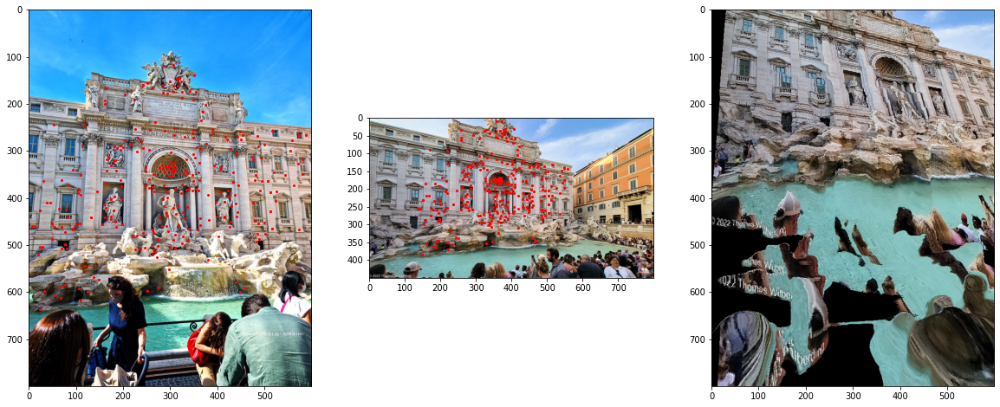

In [48]:
# def project(x, y, z, K, Rt, Rt_ref):
#     # Define the 3D position of the point
    
#     # why invert like this
#     # invert
# #     t = -R.T @ t
# #     R = R.T
            
            
#     P = np.array([x, y, z, 1])
# #     P -= t_ref
    
# #     np.linalg.inv(Rt_ref)
#     # Project the 3D position into image1
# #     x1, y1, z1 = (K @ Rt @ P)
# #     x1, y1, z1 = (K @ Rt @ np.linalg.inv(Rt_ref) @ P)
    
# #     x1, y1, z1 = (K @ Rt @ np.linalg.inv(Rt_ref) @ P)
# #     x1, y1, z1, w1 = (Rt @ np.linalg.inv(Rt_ref) @ P)
# #     x1, y1, z1, w1 = (Rt @ P)
#     x1, y1, z1, w1 = (np.linalg.inv(Rt) @ P)

# #     print(x1, y1, z1, w1)
#     return x1, y1



# def align_images(image1, image2, depth_map1):
# depth_map1 = img1_depth_map_quantized

SCALE = 100
depth_map1 = (img1_depth_map_quantized - img1_depth_map_quantized.min()) / (img1_depth_map_quantized.max() - img1_depth_map_quantized.min())
depth_map1 = depth_map1 * (max_z - min_z) + min_z
depth_map1 = depth_map1 * SCALE
# depth_map1


# depth_map1 = img1_depth_map_quantized / 255

# Initialize the result image with the same size as image1
result = np.zeros_like(img1)

# Loop over the pixels of image2
for x in tqdm(range(img1.shape[0])):
    for y in range(img1.shape[1]):
        # Get the 3D position of the current pixel
        z = depth_map1[x, y]
#         z = depth_map1[x, y] 

        # Project the 3D position into image2
#         x1, y1 = project(x, y, z, img2_intrisic, img2_extrinsic, img1_extrinsic)
        x1, y1 = project_point(x, y, z, img2_intrisic, img2_extrinsic)
                
        # Check if the projection is inside the image boundary of image1
        x1 = int(x1)
        y1 = int(y1)
        if x1 >= 0 and x1 < img2.shape[0] and y1 >= 0 and y1 < img2.shape[1]:

            result[x, y] += img2[x1, y1]
#             # Check if the pixel is occluded
#             if depth_map1[x1, y1] > z:
#                 # Inpaint the occluded pixels and add the current pixel to the result image
#                 result[x1, y1] = inpaint(x1, y1, image1, image2[i, j])
#             else:
#                 # Add the current pixel to the result image
#                 result[x1, y1] = image2[i, j]


fig, axs = plt.subplots(1, 3, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)

axs[0][0].imshow(img1)
axs[0][0].plot(pts_dst[:, 0], pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)
axs[0][1].imshow(img2)
axs[0][1].plot(pts_src[:, 0], pts_src[:, 1], color='red', linestyle='', marker='o', markersize=2)
axs[0][2].imshow(result)


100%|████████████████████████████████████████| 800/800 [00:06<00:00, 122.33it/s]


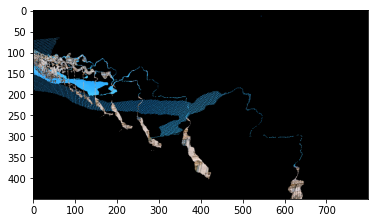

In [144]:
def project(x, y, z, K, Rt):
    # Define the 3D position of the point
    P = np.array([x, y, z, 1])
#     P = np.array([x, y, z])
    
    # Project the 3D position into image1
    x1, y1, z1 = (K @ Rt @ P)
#     print(x1, y1, z1)
    x1 = x1 / z1
    y1 = y1 / z1
#     print(x1, y1, z1)
#     qqq
#     print(x1, y1)

    return x1, y1

# def align_images(image1, image2, depth_map1):
# Convert the images to numpy arrays
# image1 = np.array(Image.open(image1))
# image2 = np.array(Image.open(image2))
depth_map1 = img1_depth_map_quantized

# Initialize the result image with the same size as image1
result = np.zeros_like(img2)

# Loop over the pixels of image2
for x in tqdm(range(img1.shape[0])):
    for y in range(img1.shape[1]):
        # Get the 3D position of the current pixel
#         x, y, z = get_3d_position(i, j, depth_map1[i, j])
        z = depth_map1[x, y]
#         z = z * 100
        z = z * 200
#         print(z)

        # Project the 3D position into image2
#         x2, y2 = project(x, y, z, img2_intrisic, img2_R, img2_T)
        x2, y2 = project(x, y, z, img2_intrisic, img2_extrinsic)
        
        # Check if the projection is inside the image boundary of image1
        if x2 >= 0 and x2 < img2.shape[0] and y2 >= 0 and y2 < img2.shape[1]:
            x2 = int(x2)
            y2 = int(y2)
            x = int(x)
            y = int(y)
            result[x2, y2] = img1[x, y]
#             # Check if the pixel is occluded
#             if depth_map1[x1, y1] > z:
#                 # Inpaint the occluded pixels and add the current pixel to the result image
#                 result[x1, y1] = inpaint(x1, y1, image1, image2[i, j])
#             else:
#                 # Add the current pixel to the result image
#                 result[x1, y1] = image2[i, j]

# return result



plt.imshow(result)

In [93]:
img1_depth_map[:, :, 1]

array([[  2,   2,   2, ...,   1,   2,   2],
       [  1,   1,   1, ...,   1,   1,   1],
       [  1,   1,   1, ...,   1,   1,   1],
       ...,
       [254, 254, 254, ..., 205, 206, 207],
       [255, 255, 255, ..., 206, 207, 208],
       [255, 255, 255, ..., 207, 208, 209]], dtype=uint8)

In [ ]:
import numpy as np

def align_images(image1, image2):
    # Get the height and width of the images
    height1, width1 = image1.shape[:2]
    height2, width2 = image2.shape[:2]

    # Create an empty image to store the aligned image2
    aligned_image = np.zeros((height1, width1, 3))

    # Loop over the pixels in image2
    for y in range(height2):
        for x in range(width2):
            # Use the depth map of image1 to infer the 3D position of the pixel
            # in image2 and project it into image1
            depth = depth_map[y, x]
            x1, y1 = project_pixel(x, y, depth)

            # Check if the projected pixel falls inside the image boundary of image1
            if 0 <= x1 < width1 and 0 <= y1 < height1:
                # Use z-buffering to account for occlusions
                if depth > aligned_image[y1, x1, 2]:
                    # Set the pixel value in the aligned image
                    aligned_image[y1, x1, :] = image2[y, x, :]

    # Inpaint any occluded pixels in the aligned image
    aligned_image = inpaint_occluded_pixels(aligned_image)

    return aligned_image

In [51]:
import cv2

# Load the two images and their depth maps into memory
img1 = cv2.imread('image1.jpg')
img2 = cv2.imread('image2.jpg')
depth1 = cv2.imread('depth1.png', cv2.IMREAD_ANYDEPTH)
depth2 = cv2.imread('depth2.png', cv2.IMREAD_ANYDEPTH)

# Create an empty image to hold the aligned version of image2
aligned_img = np.zeros_like(img1)

# Loop over all pixels in image2
for y in range(img2.shape[0]):
    for x in range(img2.shape[1]):
        # Compute the 3D position of the pixel using its depth value
        z = depth2[y, x]
        pos = np.array([x, y, z])
        
        # Project the 3D position into image1 using the camera projection matrix
        pos_img1 = projection_matrix @ pos
        
        # Convert the projected position from homogeneous coordinates to image coordinates
        x1 = pos_img1[0] / pos_img1[2]
        y1 = pos_img1[1] / pos_img1[2]
        
        # Check if the projected position falls inside the image boundary of image1
        if x1 >= 0 and x1 < img1.shape[1] and y1 >= 0 and y1 < img1.shape[0]:
            # Use z-buffering to account for occlusions
            if depth1[int(y1), int(x1)] > z:
                # Copy the pixel value from image2 to the aligned image
                aligned_img[int(y1), int(x1)] = img2[y, x]

# Inpaint any occluded pixels in the aligned image using a fast inpainting algorithm
inpainted_img = cv2.inpaint(aligned_img, occlusion_mask, 3, cv2.INPAINT_TELEA)

# Save the aligned and inpainted image to a file or display it on screen
cv2.imwrite('aligned_inpainted_image.jpg', inpainted_img)

(9, 800, 600, 3)

In [55]:
for img in image_stack:
    print(img.min(), img.max())

0 255
0 255
0 255
0 255
0 255
0 255
0 255
0 255
0 255


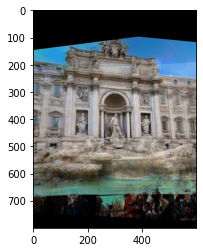

In [56]:
median_image = np.median(image_stack, axis=0)
median_image = median_image.astype(int)
plt.imshow(median_image)

In [49]:
len(image_stack)

9

In [42]:
img1.min(), img1.max(), img1.shape

(0, 255, (800, 600, 3))

In [43]:
im_dst.min(), im_dst.max(), im_dst.shape

(0, 255, (800, 600, 3))

In [44]:
(img1+im_dst)//2

array([[[ 27,  82, 127],
        [ 27,  82, 127],
        [ 26,  83, 127],
        ...,
        [  9,  65, 119],
        [  9,  64, 119],
        [  8,  63, 119]],

       [[ 26,  81, 126],
        [ 25,  82, 127],
        [ 25,  83, 127],
        ...,
        [ 10,  66, 120],
        [  7,  63, 118],
        [  5,  61, 117]],

       [[ 25,  82, 126],
        [ 26,  83, 127],
        [ 26,  84, 127],
        ...,
        [ 10,  67, 122],
        [  7,  63, 118],
        [  4,  60, 116]],

       ...,

       [[  0,   0,   0],
        [  2,   1,   1],
        [  3,   2,   2],
        ...,
        [  5,  10,  11],
        [  4,   9,   9],
        [  5,  10,  10]],

       [[  1,   1,   1],
        [  3,   2,   2],
        [  4,   3,   3],
        ...,
        [  4,   9,  10],
        [  6,  11,  12],
        [  8,  13,  12]],

       [[  1,   1,   1],
        [  3,   2,   2],
        [  4,   3,   3],
        ...,
        [  3,   8,   9],
        [  5,  10,  11],
        [  6,  10,  11]]

In [53]:
img_filename_to_num_shared_points

{'52432045605.jpg': 26,
 '52414320512.jpg': 7,
 '52358700087.jpg': 4,
 '52331623343.jpg': 23,
 '52331622658.jpg': inf,
 '52326801675.jpg': 7,
 '52205058104.jpg': 7,
 '52205048379.jpg': 15,
 '52181609863.jpg': 7,
 '52180582632.jpg': 0,
 '52158099626.jpg': 7,
 '52096939553.jpg': 13,
 '52095893822.jpg': 0,
 '52064982013.jpg': 5,
 '52038816197.jpg': 1,
 '52031879804.jpg': 7,
 '52025928811.jpg': 0,
 '52005949952.jpg': 9,
 '52005389817.jpg': 11,
 '52004310279.jpg': 0,
 '51992063097.jpg': 30,
 '51990744120.jpg': 12,
 '51974041956.jpg': 8,
 '51960745577.jpg': 0,
 '51945461230.jpg': 0,
 '51936988840.jpg': 1,
 '51932231160.jpg': 6,
 '51931613631.jpg': 0,
 '51914421801.jpg': 0,
 '51917381218.jpg': 0,
 '51902743058.jpg': 2,
 '51900154815.jpg': 0,
 '51900154465.jpg': 18,
 '51898162908.jpg': 0,
 '51897474218.jpg': inf,
 '51897600171.jpg': 22,
 '51885167223.jpg': inf,
 '51868596104.jpg': 5,
 '51829638355.jpg': 23,
 '51797234391.jpg': 18,
 '51772578990.jpg': 3,
 '51791025900.jpg': 0,
 '51742456350.jpg

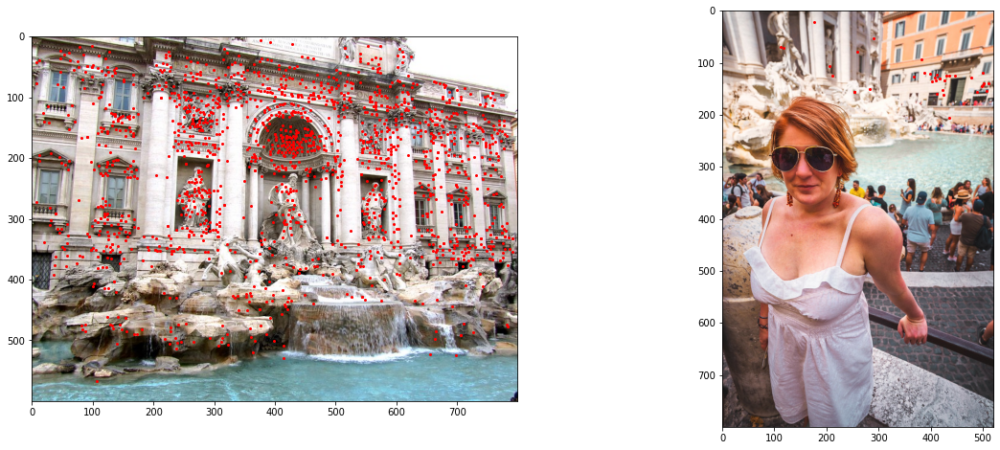

2.086941503592248 0.20925611306323677 0.7359354833000059
3.6137124129640363 -1.4623932821105585 3.2657344684880916


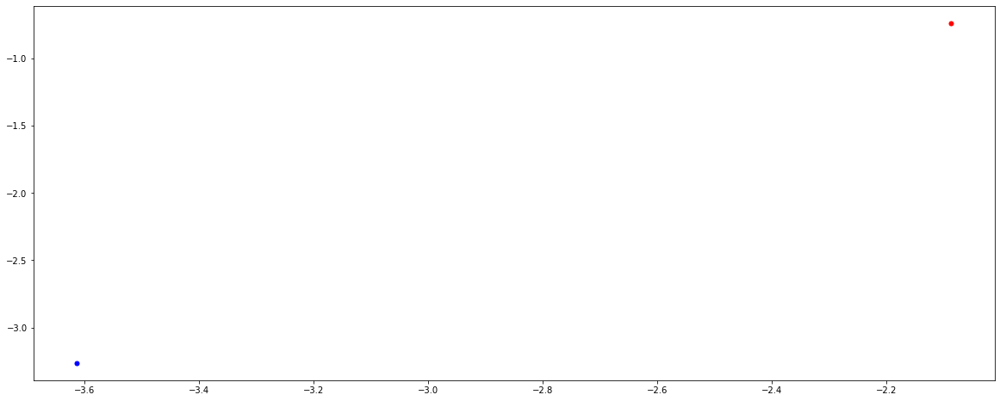

In [38]:
# # img1_filename = 'P1180196.JPG'
# # img2_filename = 'P1180195.JPG'

# # img1_filename = '52455003846.jpg'
# # img2_filename = '52301086257.jpg'
# img1_filename = '52204802313.jpg'
# img2_filename = '52177853200.jpg'
# img2_filename = '52395882667.jpg'

# trevi fountain
# img1_filename = '52397135815.jpg'
# img2_filename = '52397135940.jpg'

img1_filename = '52432045605.jpg'
img2_filename = '52331622658.jpg'

 

# # briksdalsbreen
# img1_filename = '8008454767.jpg'
# img2_filename = '6032987203.jpg'

fig, axs = plt.subplots(1, 2, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)




img1_points_2d = img_filename_to_2d_points[img1_filename]
img1_observed_points_2d = img1_points_2d[img1_points_2d[:, 2] != -1]

img1_save_path = os.path.join(data_dir, img1_filename)
img1 = cv.imread(img1_save_path)  
img1 = cv.cvtColor(img1, cv.COLOR_BGR2RGB)



_, qw1, qx1, qy1, qz1, tx1, ty1, tz1, _ = img_filename_to_metadata[img1_filename]
_, qw2, qx2, qy2, qz2, tx2, ty2, tz2, _ = img_filename_to_metadata[img2_filename]







img2_points_2d = img_filename_to_2d_points[img2_filename]
img2_observed_points_2d = img2_points_2d[img2_points_2d[:, 2] != -1]

img2_save_path = os.path.join(data_dir, img2_filename)
img2 = cv.imread(img2_save_path)  
img2 = cv.cvtColor(img2, cv.COLOR_BGR2RGB)



axs[0][0].imshow(img1)
axs[0][0].plot(img1_observed_points_2d[:, 0], img1_observed_points_2d[:, 1], color='red', linestyle='', marker='o', markersize=2)

axs[0][1].imshow(img2)
axs[0][1].plot(img2_observed_points_2d[:, 0], img2_observed_points_2d[:, 1], color='red', linestyle='', marker='o', markersize=2)
plt.show();

fig, axs = plt.subplots(1, 1, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)

print(tx1, ty1, tz1)
print(tx2, ty2, tz2)
axs[0][0].plot(-tx1, -tz1, color='red', linestyle='', marker='o', markersize=5)
axs[0][0].plot(-tx2, -tz2, color='blue', linestyle='', marker='o', markersize=5)



num_matched_points 0
0
0


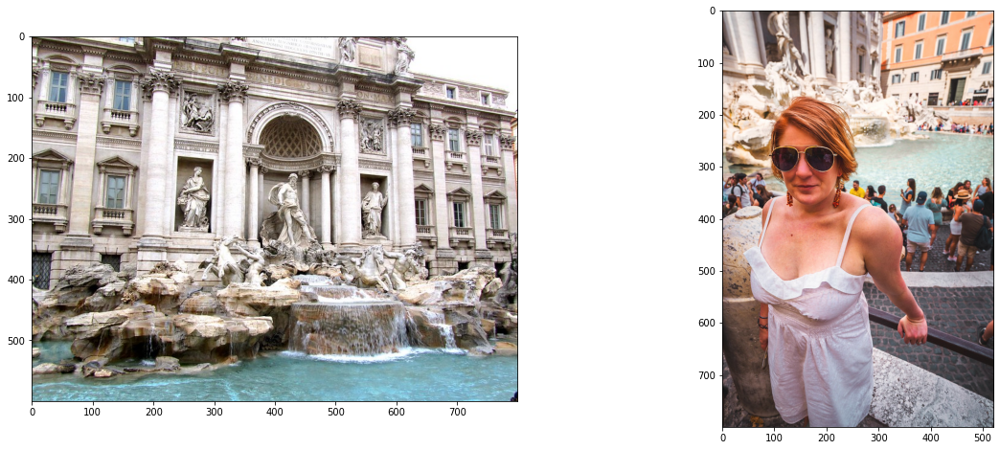

In [23]:
# remove duplicate point ids
img1_observed_point_unique_ids, img1_observed_point_unique_counts = np.unique(img1_observed_points_2d[:, 2], return_counts=True)
img1_observed_point_non_duplicates = img1_observed_point_unique_ids[img1_observed_point_unique_counts == 1]
img1_observed_points_mask = np.isin(img1_observed_points_2d[:, 2], img1_observed_point_non_duplicates)
img1_observed_points_2d = img1_observed_points_2d[img1_observed_points_mask]

img2_observed_point_unique_ids, img2_observed_point_unique_counts = np.unique(img2_observed_points_2d[:, 2], return_counts=True)
img2_observed_point_non_duplicates = img2_observed_point_unique_ids[img2_observed_point_unique_counts == 1]
img2_observed_points_mask = np.isin(img2_observed_points_2d[:, 2], img2_observed_point_non_duplicates)
img2_observed_points_2d = img2_observed_points_2d[img2_observed_points_mask]



img1_observed_point_ids = set(img1_observed_points_2d[:, 2])
img2_observed_point_ids = set(img2_observed_points_2d[:, 2])

matched_observed_point_ids = img1_observed_point_ids.intersection(img2_observed_point_ids)
matched_observed_point_ids = list(matched_observed_point_ids)
print('num_matched_points', len(matched_observed_point_ids))

img1_observed_points_mask = np.isin(img1_observed_points_2d[:, 2], matched_observed_point_ids)
img2_observed_points_mask = np.isin(img2_observed_points_2d[:, 2], matched_observed_point_ids)

print(img1_observed_points_mask.sum())
print(img2_observed_points_mask.sum())

pts_src = img2_observed_points_2d[img2_observed_points_mask] #[:, :2]
pts_dst = img1_observed_points_2d[img1_observed_points_mask] #[:, :2]

# sort by 3d point id
pts_src = pts_src[pts_src[:, 2].argsort()] 
pts_dst = pts_dst[pts_dst[:, 2].argsort()] 

# # discard 3d point id
# pts_src = pts_src[:, :2]
# pts_dst = pts_dst[:, :2]

# pts_dst = img1_observed_points_2d[:, :2]


fig, axs = plt.subplots(1, 2, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)
        
axs[0][0].imshow(img1)
axs[0][0].plot(pts_dst[:, 0], pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)
axs[0][1].imshow(img2)
axs[0][1].plot(pts_src[:, 0], pts_src[:, 1], color='red', linestyle='', marker='o', markersize=2)



In [ ]:
img1.shape, img2.shape

In [ ]:
len(pts_src), len(pts_dst)

In [ ]:
random_indices = np.random.choice(np.arange(len(pts_src)), 4, replace=False)

In [ ]:
def dist2(x, c):
    """
    dist2  Calculates squared distance between two sets of points.

    Description
    D = DIST2(X, C) takes two matrices of vectors and calculates the
    squared Euclidean distance between them.  Both matrices must be of
    the same column dimension.  If X has M rows and N columns, and C has
    L rows and N columns, then the result has M rows and L columns.  The
    I, Jth entry is the  squared distance from the Ith row of X to the
    Jth row of C.

    Adapted from code by Christopher M Bishop and Ian T Nabney.
    """
    
    ndata, dimx = x.shape
    ncenters, dimc = c.shape
    assert(dimx == dimc, 'Data dimension does not match dimension of centers')

    return (np.ones((ncenters, 1)) * np.sum((x**2).T, axis=0)).T + \
            np.ones((   ndata, 1)) * np.sum((c**2).T, axis=0)    - \
            2 * np.inner(x, c)

In [ ]:
num_iterations = int(1e4)
# num_iterations = int(1e5)

max_inliers = 0
epsilon = 1
def project(src_pts, H):
    src_pts[:, 2] = 1
#     print(src_pts.shape)
#     print(H.shape)
    projected_points = src_pts.dot(H) #H.dot(src_pts)
#     print(projected_points)
    projected_points = projected_points / projected_points[:, 2].reshape(-1, 1)
#     projected_points[:, 0] = projected_points[:, 0] / projected_points[:, 2]
#     projected_points[:, 1] = projected_points[:, 1] / projected_points[:, 2]
#     projected_points[:, 2] = projected_points[:, 2] / projected_points[:, 2]
#     print(projected_points)
    return projected_points


for _ in tqdm(range(num_iterations)):
    random_indices = np.random.choice(np.arange(len(pts_src)), 4, replace=False)
    random_pts_src = pts_src[random_indices] 
    random_pts_dst = pts_dst[random_indices] 
    
    H, status = cv.findHomography(random_pts_src[:, :2], random_pts_dst[:, :2], 0)
    H = H.T
    projected_points = project(pts_src.copy(), H)
#     distances = dist2(pts_dst[:, :2], projected_points[:, :2])
    distances = (((pts_dst[:, :2] - projected_points[:, :2])**2).sum(axis=1)**0.5)
    num_inliers = (distances < epsilon).sum()
    
    # Keep largest set of inliers
    if num_inliers > max_inliers:
        print('max_inliers', max_inliers)
        max_inliers = num_inliers
        inlier_cordinates_for_maximum = np.where(distances < epsilon)
        

In [ ]:
# pts_dst.shape

In [ ]:
# (((pts_dst[:, :2] - projected_points[:, :2])**2).sum(axis=1)**0.5) #.shape

In [ ]:
# pts_dst[:, :2]

In [ ]:
# projected_points[:, :2]

In [ ]:
inlier_cordinates_for_maximum

In [ ]:
inlier_pts_src = pts_src[inlier_cordinates_for_maximum[0]] 
inlier_pts_dst = pts_dst[inlier_cordinates_for_maximum[0]] 
print(len(inlier_pts_src), len(inlier_pts_dst))

In [ ]:
H, status = cv.findHomography(inlier_pts_src[:, :2], inlier_pts_dst[:, :2], 0)
im_dst = cv.warpPerspective(img2, H, (img1.shape[1], img1.shape[0]))

fig, axs = plt.subplots(1, 3, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)
        
axs[0][0].imshow(img1)
# axs[0][0].plot(pts_dst[:, 0], pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)
axs[0][0].plot(inlier_pts_dst[:, 0], inlier_pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)
axs[0][1].imshow(img2)
# axs[0][1].plot(pts_src[:, 0], pts_src[:, 1], color='red', linestyle='', marker='o', markersize=2)
axs[0][1].plot(inlier_pts_src[:, 0], inlier_pts_src[:, 1], color='red', linestyle='', marker='o', markersize=2)

axs[0][2].imshow(im_dst)

In [ ]:
def get_image_intrisics(camera_id, camera_id_to_data):
    data = camera_id_to_data[camera_id]
    model = data['model']
    params = data['params']
    
    if model in ['SIMPLE_PINHOLE', 'SIMPLE_RADIAL', 'RADIAL']:
        fx, fy, cx, cy = params
        
    # intrinsics
    K = np.identity(3)
    K[0, 0] = fx
    K[1, 1] = fy
    K[0, 2] = cx
    K[1, 2] = cy
    return K


def qvec2rotmat(qvec):
    return np.array([
        [1 - 2 * qvec[2]**2 - 2 * qvec[3]**2,
         2 * qvec[1] * qvec[2] - 2 * qvec[0] * qvec[3],
         2 * qvec[3] * qvec[1] + 2 * qvec[0] * qvec[2]],
        [2 * qvec[1] * qvec[2] + 2 * qvec[0] * qvec[3],
         1 - 2 * qvec[1]**2 - 2 * qvec[3]**2,
         2 * qvec[2] * qvec[3] - 2 * qvec[0] * qvec[1]],
        [2 * qvec[3] * qvec[1] - 2 * qvec[0] * qvec[2],
         2 * qvec[2] * qvec[3] + 2 * qvec[0] * qvec[1],
         1 - 2 * qvec[1]**2 - 2 * qvec[2]**2]])

def get_image_extrinsics(img_filename, img_filename_to_metadata):
    image_id, qw, qx, qy, qz, tx, ty, tz, camera_id = img_filename_to_metadata[img_filename]
    R = qvec2rotmat([qw, qx, qy, qz])
    T = np.array([tx, ty, tz])
    return R, T
    
_, _, _, _, _, _, _, _, img1_camera_id = img_filename_to_metadata[img1_filename]
_, _, _, _, _, _, _, _, img2_camera_id = img_filename_to_metadata[img2_filename]

img2_intrisic = get_image_intrisics(img2_camera_id, camera_id_to_data)
img2_R, img2_T = get_image_extrinsics(img2_filename, img_filename_to_metadata)
img2_extrinsic = np.hstack((img2_R, np.expand_dims(img2_T, axis=1)))
img2_intrisic, img2_extrinsic

In [ ]:
_, _, _, _, _, _, _, _, img1_camera_id = img_filename_to_metadata[img1_filename]
_, _, _, _, _, _, _, _, img2_camera_id = img_filename_to_metadata[img2_filename]

In [ ]:
img1_intrisic = get_image_intrisics(img1_camera_id, camera_id_to_data)
img1_R, img1_T = get_image_extrinsics(img1_filename, img_filename_to_metadata)
img1_extrinsic = np.hstack((img1_R, np.expand_dims(img1_T, axis=1)))
img1_intrisic, img1_extrinsic

In [ ]:
img2_intrisic = get_image_intrisics(img2_camera_id, camera_id_to_data)
img2_R, img2_T = get_image_extrinsics(img2_filename, img_filename_to_metadata)
img2_extrinsic = np.hstack((img2_R, np.expand_dims(img2_T, axis=1)))
img2_intrisic, img2_extrinsic

In [ ]:
essential_matrix_1 = img1_intrisic@img1_extrinsic
essential_matrix_2 = img2_intrisic@img2_extrinsic
essential_matrix_1, essential_matrix_2

In [ ]:
points_4d_ids = inlier_pts_dst[:, 2]

points_4d = []
for pid in points_4d_ids:
    x, y, z, _, _, _ = point_id_to_data[str(int(pid))]
    points_4d.append([x, y, z, 1])
points_4d = np.array(points_4d)
points_4d = points_4d.astype(float)

num_depth_planes = 10

min_d, max_d = min(points_4d[:, 2]), max(points_4d[:, 2])
depths = np.linspace(min_d, max_d, num_depth_planes, dtype=float)
depths

In [ ]:
# depths = [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000]

In [ ]:
# # compare to 3d points?
# # no need to do this since we have the 3d points already?
# # points_4d = cv.triangulatePoints(essential_matrix_1, essential_matrix_2, pts_dst[:, :2].T, pts_src[:, :2].T)
# points_4d = cv.triangulatePoints(essential_matrix_1, essential_matrix_2, inlier_pts_dst[:, :2].T, inlier_pts_src[:, :2].T)
# print(points_4d.shape)

# i = 0
# for x in points_4d[3]:
#     points_4d[0][i] = points_4d[0][i]/x
#     points_4d[1][i] = points_4d[1][i]/x
#     points_4d[2][i] = points_4d[2][i]/x
#     points_4d[3][i] = points_4d[3][i]/x
#     i += 1

# flag = 0
# for x in points_4d[2]:
#     if x < 0:
#         flag = 1
        
# num_depth_planes = 10

# min_d, max_d = min(points_4d[2]), max(points_4d[2])
# depths = np.linspace(min_d, max_d, num_depth_planes, dtype=float)
# depths

In [ ]:
np.array([0, 0, 1]).reshape(-1, 1).T.shape

In [ ]:
def compute_homography(img1_intrisic, img1_extrinsic, img2_intrisic, img2_extrinsic, d):
#     n_m = np.array([0, 0, 1])
    n_m = np.array([0, 0, 1]).reshape(-1, 1).T
    
    K_ref = img1_intrisic
    R_ref = img1_extrinsic[:, :3]
    t_ref = img1_extrinsic[:, 3].reshape(-1, 1)
    
    K_other = img2_intrisic
    R_other = img2_extrinsic[:, :3]
    t_other = img2_extrinsic[:, 3].reshape(-1, 1)
    
    # K_ref should be identity?
#     H = K @ (R - ((tvec@n_m)/d)) @ np.linalg.inv(K_ref)
#     R should be mapping from plane to ref. here ref is camera, not image1
#     H = K_other @ (R_other.T + (R_other.T*(t_other@n_m)/d)) @ np.linalg.inv(K_ref)

#     R = R_other.T@R_ref
#     t = -t_other + t_ref
    
    R = R_other@R_ref.T
    t = t_other - t_ref
#     print(t)
#     H = K_other @ (R + (R*(t@n_m)/d)) @ np.linalg.inv(K_ref)
#     H = K_other @ (R.T + (R.T*(t@n_m)/d)) @ np.linalg.inv(K_ref)
#     H = K_other @ (R - ((t@n_m)/d)) @ np.linalg.inv(K_ref)
    
#     print((R_other.T@t_other).shape)
#     H = K_other @ (R_other.T + ((R_other.T@t_other@n_m)/d)) @ np.linalg.inv(K_ref)

#     H = K_other @ (R + ((t@n_m)/d)) @ np.linalg.inv(K_ref)
    H = K_other @ (R + ((R@t@n_m)/d)) @ np.linalg.inv(K_ref)
    
#     H = K_other @ (R.T + ((R.T@t@n_m)/d)) @ np.linalg.inv(K_ref)
    
#     print(((R_other.T@t_other@n_m)/d))
#     H = H/H[2][2]
#     print(H)
    
    return H

def compute_homography(img1_intrisic, img1_extrinsic, img2_intrisic, img2_extrinsic, d):
    n_m = np.array([0, 0, 1]).reshape(-1, 1)
    
    K_ref = img1_intrisic
    R_ref = img1_extrinsic[:, :3]
    t_ref = img1_extrinsic[:, 3].reshape(-1, 1)
    
    K_other = img2_intrisic
    R_other = img2_extrinsic[:, :3]
    t_other = img2_extrinsic[:, 3].reshape(-1, 1)
        
#     H = K_other @ (R_other.T + ((R_other.T@t_other@n_m.T) / d)) @ np.linalg.inv(K_ref)
    H = K_other @ (R_other - ((t_other@n_m.T) / d)) @ np.linalg.inv(K_ref)
    
    return H

In [ ]:
fig, axs = plt.subplots(1 + len(depths)//2, 2, squeeze=False)
fig.set_figheight(axs.shape[0] * 5)
fig.set_figwidth(axs.shape[1] * 5)
    
row = 0  
col = 0

axs[row][0].imshow(img1)
axs[row][0].set_title('img1')
axs[row][1].imshow(img2)
axs[row][1].set_title('img2')

row += 1

for d in depths:
    H = compute_homography(img1_intrisic, img1_extrinsic, img2_intrisic, img2_extrinsic, d)
    H_inv = np.linalg.inv(H)
    
#     H = compute_homography(img2_intrisic, img2_extrinsic, img1_intrisic, img1_extrinsic, d)
#     H_inv = H

    
    img2_warped = cv.warpPerspective(img2, H_inv, (img1.shape[1], img1.shape[0]))
    axs[row][col].imshow(img2_warped)
    axs[row][col].set_title(f'depth {d}')
    
    if col == 1:
        col = 0
        row += 1
    else:
        col = 1

In [ ]:
img1_intrisic, img1_extrinsic, img2_intrisic, img2_extrinsic

zero = np.array([0, 0, 0]).reshape(3, 1)
projection_1 = np.matmul(img1_intrisic, np.hstack((np.identity(3), zero)))
projection_1

# combinations = [(R1, t), (R2, t), (R1, -1*t), (R2, -1*t)]

for (rot, trans) in combinations:
    projection_2 = np.matmul(img2_intrisic, np.hstack((rot, trans)))


In [ ]:
def unproject_corners(K, width, height, depth, Rt):
    invK = np.linalg.inv(K)

    points = np.array((
        (0, 0, 1),
        (width, 0, 1),
        (0, height, 1),
        (width, height, 1),
    ), dtype=np.float32).reshape(2, 2, 3)

    points = np.tensordot(points, invK.T, axes=1)
    points *= depth
    points = np.tensordot(points, Rt[:3, :3], axes=1)
    points += -Rt[:3, :3].T.dot(Rt[:3, 3])
    return points

def project_impl(K, Rt, points):
    """
    Project 3D points into a calibrated camera.
    Input:
        K -- camera intrinsics calibration matrix
        Rt -- 3 x 4 camera extrinsics calibration matrix
        points -- height x width x 3 array of 3D points
    Output:
        projections -- height x width x 2 array of 2D projections
    """
    # Create projection matrix
    projection_Matrix = np.dot(K, Rt)

    # Switch from 3D coordinates to homogeneous coordinates
    extra_ones = np.tile([1], points.shape[0]*points.shape[1])
    extra_ones = extra_ones.reshape((points.shape[0], points.shape[1],1))
    h_points = np.concatenate((points, extra_ones), axis=2)
    xs  = np.dot(h_points, projection_Matrix.T)
    # Normalize to convert back from homogeneous coordinates to 2D coordinates
    deno = xs[:,:,2][:,:,np.newaxis]
    normalized_xs = xs / deno

    return normalized_xs[:,:,:2]


# img1_intrisic, img1_extrinsic, img2_intrisic, img2_extrinsic

# zero = np.array([0, 0, 0]).reshape(3, 1)
# projection_1 = np.matmul(img1_intrisic, np.hstack((np.identity(3), zero)))
# projection_1

# # combinations = [(R1, t), (R2, t), (R1, -1*t), (R2, -1*t)]

# for (rot, trans) in combinations:
#     projection_2 = np.matmul(img2_intrisic, np.hstack((rot, trans)))

    
K_right = img1_intrisic
height, width, _ = img1.shape
depth = 1
Rt_right = img1_extrinsic
points = unproject_corners(K_right, width, height, depth, Rt_right)
points.shape

# K = K_right
# Rt = img1_extrinsic
# project_impl(K, Rt, points)
# points_left = project(K_left, Rt_left, points)
points_right = project_impl(K_right, Rt_right, points)
# points_right
points_right = points_right.reshape(-1, 2)
points_right

fig, axs = plt.subplots(1, 2, squeeze=False)
fig.set_figheight(axs.shape[0] * 5)
fig.set_figwidth(axs.shape[1] * 7)
    
row = 0  
col = 0

axs[row][0].imshow(img1)
axs[row][0].plot(points_right[:, 0], points_right[:, 1], color='red', linestyle='', marker='o', markersize=5)
axs[row][0].set_title('img1')
axs[row][1].imshow(img1)
axs[row][1].set_title('img1')


In [ ]:
# points_right = points_right.reshape(-1, 2)

In [ ]:
fig, axs = plt.subplots(1, 2, squeeze=False)
fig.set_figheight(axs.shape[0] * 5)
fig.set_figwidth(axs.shape[1] * 7)
    
row = 0  
col = 0

axs[row][0].imshow(img1)
axs[row][0].plot(points_right[:, 0], points_right[:, 1], color='red', linestyle='', marker='o', markersize=5)
axs[row][0].set_title('img1')
axs[row][1].imshow(img1)
axs[row][1].set_title('img1')


In [ ]:
img1_extrinsic

In [ ]:
img1.shape

In [ ]:
qqq

In [ ]:
def _compute_homography(img_intrisic, img_extrinsic, d):
    n_m = np.array([0, 0, 1]).reshape(-1, 1)
    
    K = img_intrisic
    R = img_extrinsic[:, :3]
    t = img_extrinsic[:, 3].reshape(-1, 1)
        
    H = K @ (R.T + ((R.T@t@n_m.T)/d)) @ np.eye(3)
    
    return H


fig, axs = plt.subplots(1 + len(depths)//2, 2, squeeze=False)
fig.set_figheight(axs.shape[0] * 5)
fig.set_figwidth(axs.shape[1] * 5)
    
row = 0  
col = 0

axs[row][0].imshow(img1)
axs[row][1].imshow(img2)
row += 1

for d in depths:
    H_1 = _compute_homography(img1_intrisic, img1_extrinsic, d)
#     H_2 = _compute_homography(img1_intrisic, img1_extrinsic, d)
#     H_inv = H_1 @ np.linalg.inv(H_2)
#     H_inv =  np.linalg.inv(H_1)@H_2
    H_inv = np.linalg.inv(H_1)
    
    img2_warped = cv.warpPerspective(img1, H_inv, (img1.shape[1], img1.shape[0]))
    axs[row][col].imshow(img2_warped)
    axs[row][col].set_title(f'depth {d}')
    
    if col == 1:
        col = 0
        row += 1
    else:
        col = 1

In [ ]:
# img2_warped_copy = img2_warped.copy()

In [ ]:
H_inv = np.linalg.inv(H)
H_inv

In [ ]:
fig, axs = plt.subplots(1, 3, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)
    
# img2_warped = cv.warpPerspective(img2, H_inv, (img1.shape[1]*4, img1.shape[0]*4))
img2_warped = cv.warpPerspective(img2, H_inv, (img1.shape[1], img1.shape[0]))
# img2_warped = cv.warpPerspective(img1, H_inv, (WIDTH, HEIGHT))

    
axs[0][0].imshow(img1)
axs[0][1].imshow(img2)
axs[0][2].imshow(img2_warped)


In [ ]:
fig, axs = plt.subplots(1, 3, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)
    
# img2_warped = cv.warpPerspective(img2, H_inv, (img1.shape[1]*4, img1.shape[0]*4))
img2_warped = cv.warpPerspective(img2, H_inv, (img1.shape[1], img1.shape[0]))
# img2_warped = cv.warpPerspective(img1, H_inv, (WIDTH, HEIGHT))

    
axs[0][0].imshow(img1)
axs[0][1].imshow(img2)
axs[0][2].imshow(img2_warped)


In [ ]:
n_m = np.array([0, 0, 1])
n_m

In [ ]:
tvec = np.array([tx, ty, tz])
tvec

In [ ]:
qvec = np.array([qw, qx, qy, qz])
R = qvec2rotmat(qvec)
R

In [ ]:
np.linalg.inv(R), R.T

In [ ]:
# d_m = 10
# R = np.linalg.inv(R)
# H = K @ (R - (tvec@n_m)/d_m) @ np.linalg.inv(K)

In [ ]:
d_m = 100

# K_ref should be identity?
H = K @ (R.T + (R.T*(tvec@n_m)/d_m)) @ np.linalg.inv(K_ref)

H_inv = np.linalg.inv(H)
H_inv

In [ ]:
fig, axs = plt.subplots(1, 2, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)
    
# im_dst = cv.warpPerspective(img1, H_inv, (img1.shape[1], img1.shape[0]))
im_dst = cv.warpPerspective(img1, H_inv, (WIDTH, HEIGHT))

    
axs[0][0].imshow(img1)
axs[0][1].imshow(im_dst)
# axs[0][0].plot(pts_dst[:, 0], pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)
# axs[0][1].imshow(im_dst)
# axs[0][1].plot(pts_dst[:, 0], pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)

# im_blended = (img1 + im_dst) / 2
# axs[0][2].imshow(im_blended)





In [ ]:
# pts_src[pts_src[:, 2].argsort()]

In [ ]:
# pts_dst[pts_dst[:, 2].argsort()]

In [ ]:
print(len(pts_src))
print(len(pts_dst))

In [ ]:
h, status = cv.findHomography(pts_src, pts_dst)
# h, status = cv.findHomography(pts_dst, pts_src)
status

In [ ]:
fig, axs = plt.subplots(1, 3, squeeze=False)
fig.set_figheight(8)
fig.set_figwidth(20)
        
    
im_dst = cv.warpPerspective(img2, h, (img1.shape[1], img1.shape[0]))

axs[0][0].imshow(img1)
axs[0][0].plot(pts_dst[:, 0], pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)
axs[0][1].imshow(im_dst)
axs[0][1].plot(pts_dst[:, 0], pts_dst[:, 1], color='red', linestyle='', marker='o', markersize=2)

im_blended = (img1 + im_dst) / 2
axs[0][2].imshow(im_blended)





In [ ]:
for img1_filename in img_filename_to_metadata:
#     img1_filename = 'P1180196.JPG'
    img1_points_2d = img_filename_to_2d_points[img1_filename]
    img1_observed_points_2d = img1_points_2d[img1_points_2d[:, 2] != -1]
#     print(len(img1_observed_points_2d))

    img1_save_path = os.path.join(data_dir, img1_filename)
    img1 = cv.imread(img1_save_path)  
    img1 = cv.cvtColor(img1, cv.COLOR_BGR2RGB)
    plt.imshow(img1)
    plt.plot(img1_observed_points_2d[:, 0], img1_observed_points_2d[:, 1], color='red', linestyle='', marker='o', markersize=2)
    plt.show();

In [ ]:
len(matches)

In [ ]:
matches[mask[:, 0]]

In [ ]:
mask.sum()

In [ ]:
# len(data[0]['shots']) + len(data[1]['shots']) + len(data[2]['shots']) + len(data[3]['shots'])

cluster_id = 0
cluster_data = data[cluster_id]
print(cluster_data.keys())
cluster_data['shots']

num_imgs_in_cluster = len(cluster_data['shots'])
print('num_imgs_in_cluster', num_imgs_in_cluster)

# fig, axs = plt.subplots(num_imgs_in_cluster, 1, squeeze=False)
# fig.set_figheight(5*num_imgs_in_cluster)
# fig.set_figwidth(20)


fig, axs = plt.subplots(20, 3, squeeze=False)
fig.set_figheight(7*20)
fig.set_figwidth(20)
        

# Initiate SIFT detector
sift = cv.SIFT_create()

count = 0

for index, img1_filename in enumerate(cluster_data['shots']):
    if index == 0:
        continue
    print(img1_filename)
    img1_save_path = os.path.join(data_dir, img1_filename)
    img1 = cv.imread(img1_save_path, cv.IMREAD_GRAYSCALE)  
        
    for index, img2_filename in enumerate(cluster_data['shots']):

        if img1_filename == img2_filename:
            continue
            
        img2_save_path = os.path.join(data_dir, img2_filename)
        img2 = cv.imread(img2_save_path, cv.IMREAD_GRAYSCALE)  
    
        # find the keypoints and descriptors with SIFT
        kp1, des1 = sift.detectAndCompute(img1,None)
        kp2, des2 = sift.detectAndCompute(img2,None)
        # BFMatcher with default params
        bf = cv.BFMatcher()
        matches = bf.knnMatch(des1, des2, k=2)


        # Apply ratio test
        good = []
        for m,n in matches:
            if m.distance < 0.7*n.distance:
                good.append([m])
        # cv.drawMatchesKnn expects list of lists as matches.

        img3 = cv.drawMatchesKnn(img1,kp1,img2,kp2,good,None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)



        axs[count][0].imshow(img1, cmap='gray')
        axs[count][1].imshow(img2, cmap='gray')

#         fig, axs = plt.subplots(1, 1, squeeze=False)
#         fig.set_figheight(10)
#         fig.set_figwidth(20)
        axs[count][2].imshow(img3, cmap='gray')

        
        count += 1
        if count == 20:
            break
#         qqq





In [ ]:
points = []
for index, img_filename in enumerate(cluster_data['shots']):
    img_id = img_filename.replace('.jpg', '')
    try:
        img_metadata = metadata[img_id]
    except:
        continue
    points.append([img_metadata['latitude'], img_metadata['longitude']])
points = np.array(points)
points = points.astype(float)
np.shape(points)

In [ ]:
print(min(points[:, 0]), max(points[:, 0]))
print(min(points[:, 1]), max(points[:, 1]))

In [ ]:
type(min(points[:, 0])) # + 0.1

In [ ]:
plt.figure(figsize=(8, 8))
plt.scatter(points[:, 0], points[:, 1])
plt.xlim(41.8, 42.1)
# plt.xlim(min(points[:, 0]), min(points[:, 0]) + 0.1)
plt.ylim(12.48, 12.51)
plt.grid()
plt.show();

In [ ]:
img1_filename.replace('.jpg', '')

In [ ]:
len(cluster_data['shots'])

In [ ]:

fig, axs = plt.subplots(10, 2, squeeze=False)
fig.set_figheight(30)
fig.set_figwidth(20)
   
count = 0    

        
for index, img1_filename in enumerate(cluster_data['shots']):
    try:
        depthmap_data = np.load(f'data/rome_colosseum/undistorted/depthmaps/{img1_filename}.clean.npz')
    except:
        continue
    depthmap = depthmap_data['depth']
#     print(depthmap.min(), depthmap.max())
    if depthmap.max() > 0:
        print(img1_filename, depthmap.min(), depthmap.max())
        
        
        img1_save_path = os.path.join(data_dir, img1_filename)
        img1 = cv.imread(img1_save_path, cv.IMREAD_GRAYSCALE)  
        axs[count][0].imshow(img1, cmap='gray')
        axs[count][1].imshow(depthmap, cmap='viridis')
        count += 1
        if count == 10:
            break
#         qqq
# count

In [ ]:
depthmap.shape

In [ ]:
tracks_df = pd.read_table('data/rome_colosseum/tracks.csv')
tracks_df.reset_index()

In [ ]:
cluster_data.keys()

In [ ]:
cluster_data['shots'] #['52507892218.jpg']

In [ ]:
# Initiate SIFT detector
sift = cv.SIFT_create()

for img1_filename in filenames:
    img1 = cv.imread(img1_filename, cv.IMREAD_GRAYSCALE)          # queryImage
    for img2_filename in filenames:
        if img1_filename == img2_filename:
            continue
        img2 = cv.imread(img2_filename, cv.IMREAD_GRAYSCALE)       
#     plt.imshow(img1, cmap='gray')
#     qqq


        # find the keypoints and descriptors with SIFT
        kp1, des1 = sift.detectAndCompute(img1,None)
        kp2, des2 = sift.detectAndCompute(img2,None)
        # BFMatcher with default params
        bf = cv.BFMatcher()
        matches = bf.knnMatch(des1,des2,k=2)
        
        
        # Apply ratio test
        good = []
        for m,n in matches:
            if m.distance < 0.75*n.distance:
                good.append([m])
        # cv.drawMatchesKnn expects list of lists as matches.
        
        img3 = cv.drawMatchesKnn(img1,kp1,img2,kp2,good,None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        
        fig, axs = plt.subplots(1, 2, squeeze=False)
        fig.set_figheight(10)
        fig.set_figwidth(20)
        
        axs[0][0].imshow(img1, cmap='gray')
        axs[0][1].imshow(img2, cmap='gray')
        
        fig, axs = plt.subplots(1, 1, squeeze=False)
        fig.set_figheight(10)
        fig.set_figwidth(20)
        axs[0][0].imshow(img3, cmap='gray')


        qqq


In [ ]:
len(data[0]['shots']) + len(data[1]['shots']) + len(data[2]['shots']) + len(data[3]['shots'])

In [ ]:
photo_id_to_metadata

In [ ]:
photo_id = '48876858817'
img_filename = f'{photo_id}.jpg'
img_save_path = os.path.join(data_dir, img_filename)
img1 = cv.imread(img_save_path,cv.IMREAD_GRAYSCALE)          # queryImage
plt.imshow(img1, cmap='gray')

In [ ]:
sift = cv.SIFT_create()
kp1, des1 = sift.detectAndCompute(img1,None)

In [ ]:
des1.shape

In [ ]:
# img1 = cv.imread('box.png',cv.IMREAD_GRAYSCALE)          # queryImage
# img2 = cv.imread('box_in_scene.png',cv.IMREAD_GRAYSCALE) # trainImage
# # Initiate SIFT detector
# sift = cv.SIFT_create()
# # find the keypoints and descriptors with SIFT
# kp1, des1 = sift.detectAndCompute(img1,None)

In [ ]:

# fig, axs = plt.subplots(10, 1, squeeze=False)
# fig.set_figheight(20)
# fig.set_figwidth(10)

In [ ]:
photos = flickr.walk(text=keyword,
                     tag_mode='all',
                     tags=keyword,
                     extras='url_c',
                     per_page=100,           # may be you can try different numbers..
                     sort='relevance')
photos